Imports and configs

In [1]:
import os
import cv2
import json
import torch
import numpy as np
import supervision as sv
import pycocotools.mask as mask_util
from glob import glob
from pathlib import Path
from torchvision.ops import box_convert
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor
from grounding_dino.groundingdino.util.inference import load_model, load_image, predict
import matplotlib.pyplot as plt
import time

# Config parameters
DATASET_DIR = "C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000"
image_paths = sorted(glob(os.path.join(DATASET_DIR, "*.jpg")))
SAM2_CHECKPOINT = "./checkpoints/sam2.1_hiera_large.pt"
SAM2_MODEL_CONFIG = "configs/sam2.1/sam2.1_hiera_l.yaml"
GROUNDING_DINO_CONFIG = "grounding_dino/groundingdino/config/GroundingDINO_SwinT_OGC.py"
GROUNDING_DINO_CHECKPOINT = "gdino_checkpoints/groundingdino_swint_ogc.pth"
# BOX_THRESHOLD = 0.35
# TEXT_THRESHOLD = 0.25
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" 

# Output directory
OUTPUT_DIR = Path("outputs/results_stuff")
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

Load annotations file

In [2]:
import pickle

# Path to your annotations .pkl file
ANNOTATION_FILE = "C:/Users/User/Projects/ObjectDetection/object_detection_exploration/filtered_coco_stuff.pkl"

# Load the pickle file
with open(ANNOTATION_FILE, "rb") as f:
    coco_data = pickle.load(f)

# Unpack the components
annotations = coco_data["annotations"]      # list of annotation dicts
images = coco_data["images"]                # list of image dicts
categories = coco_data["categories"]        # list of category dicts

# Build mappings
cat_id_to_name = {cat["id"]: cat["name"] for cat in categories}
cat_name_to_id = {cat["name"]: cat["id"] for cat in categories}
img_id_to_file = {img["id"]: img["file_name"] for img in images}

# Group labels by image_id
from collections import defaultdict

img_id_to_labels = defaultdict(set)
for ann in annotations:
    img_id = ann["image_id"]
    cat_id = ann["category_id"]
    label = cat_id_to_name[cat_id]
    img_id_to_labels[img_id].add(label)

In [4]:
print(coco_data["categories"][:3])

[{'supercategory': 'textile', 'id': 92, 'name': 'banner'}, {'supercategory': 'textile', 'id': 93, 'name': 'blanket'}, {'supercategory': 'plant', 'id': 94, 'name': 'branch'}]


Load models

In [3]:
print("Loading SAM2 model...")
sam2_model = build_sam2(SAM2_MODEL_CONFIG, SAM2_CHECKPOINT, device=DEVICE)
sam2_predictor = SAM2ImagePredictor(sam2_model)

print("Loading Grounding DINO model...")
grounding_model = load_model(
    model_config_path=GROUNDING_DINO_CONFIG,
    model_checkpoint_path=GROUNDING_DINO_CHECKPOINT,
    device=DEVICE
)

print("Models loaded.")

Loading SAM2 model...
Loading Grounding DINO model...


final text_encoder_type: bert-base-uncased
Models loaded.


Normalize class labels that have the suffix '-stuff' '-other'

In [4]:
def normalize_label(label):
    if label.endswith("-stuff"):
        label = label[:-6]  
    elif label.endswith("-other"):
        label = label[:-6]

    # Reformat labels with a dash (e.g., wall-brick -> brickwall)
    if '-' in label:
        parts = label.split('-')
        if len(parts) == 2:
            return parts[1] + parts[0]

    return label

# Normalize categories and build mappings
cat_id_to_name = {cat["id"]: normalize_label(cat["name"]) for cat in categories}
cat_name_to_id = {name: id for id, name in cat_id_to_name.items()}

In [ ]:
FILTERED_CLASSES_RAW = [
    "wall-brick", "wall-concrete", "wall-other", "wall-panel", "wall-stone", "wall-tile", "wall-wood",
    "window-blind", "window-other", "ceiling-other", "ceiling-tile", "floor-marble", "floor-other", "floor-stone", "floor-tile", "floor-wood", "ground-other",
    "desk-stuff", "door-stuff", "counter", "gravel", "grass", "road", "pavement", "sand", "mud", "railroad", "stairs", "building-other", "bridge", "platform",
]

FILTERED_CLASSES = set(
    normalized for c in FILTERED_CLASSES_RAW
    if (normalized := normalize_label(c)) is not None
)

def single_mask_to_rle(mask):
    rle = mask_util.encode(np.array(mask[:, :, None], order="F", dtype="uint8"))[0]
    rle["counts"] = rle["counts"].decode("utf-8")
    return rle

# Reverse mapping for filename -> image_id
file_to_img_id = {v: k for k, v in img_id_to_file.items()}

- box_threshold: Filters bounding box detections based on how confident Grounding DINO is that an object is present in that box, relevant to the caption. It's about "Is there an object here?"

- text_threshold: Filters the specific textual labels/phrases associated with each detected box, based on how confident Grounding DINO is that a particular word/phrase accurately describes the object in that box. It's about "What exactly is this object?"

- sam_iou_threshold: Filters segmentation masks based on how confident SAM-2 is about the quality (IoU) of each generated mask. It's about "How good is this segmentation mask?"

## Inference Test 1
- 2996 images total
- set text threshold of 0.25 and box threshold of 0.35
- output results json file with all segmentation masks done
- model outputs instance segmentation masking for every different object
- will have to merge masks of the same class in a single image together 

In [16]:
from pathlib import Path
import numpy as np
import torch
import supervision as sv
from torchvision.ops import box_convert
import json
import time

# --- Configuration ---
OUTPUT_DIR = Path("outputs/results_stuff")
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

BOX_THRESHOLD = 0.1
TEXT_THRESHOLD = 0.25
SAM_IOU_THRESHOLD = 0.0 # this refers to the score given by SAM2 on the estimation of IoU between predicted and GT boxes, 'score'

all_results = []

total_images = len(image_paths)
start_time = time.time()

for idx, image_path in enumerate(image_paths):
    filename = Path(image_path).name

    elapsed_time = time.time() - start_time
    if idx == 0:
        eta_str = "Calculating..."
    else:
        time_per_image_avg = elapsed_time / idx
        remaining_images = total_images - (idx + 1)
        eta_seconds = time_per_image_avg * remaining_images
        if eta_seconds < 60:
            eta_str = f"{int(eta_seconds)}s left"
        elif eta_seconds < 3600:
            minutes = int(eta_seconds // 60)
            seconds = int(eta_seconds % 60)
            eta_str = f"{minutes}m {seconds}s left"
        else:
            hours = int(eta_seconds // 3600)
            minutes = int((eta_seconds % 3600) // 60)
            eta_str = f"{hours}h {minutes}m left"

    print(f"[{idx+1}/{total_images}] Processing: {filename} | ETA: {eta_str}")

    image_id = file_to_img_id.get(filename)

    if image_id is None:
        print(f"  No annotations found for image {filename}, skipping.")
        continue

    labels_for_image = img_id_to_labels.get(image_id, set())
    labels_for_image_norm = set(
        normalized for l in labels_for_image
        if (normalized := normalize_label(l)) is not None
    )
    filtered_labels_for_image = labels_for_image_norm.intersection(FILTERED_CLASSES)

    if not filtered_labels_for_image:
        print(f"  No filtered labels for image {filename}, skipping.")
        continue

    image_source, image = load_image(image_path)
    sam2_predictor.set_image(image_source)

    all_boxes = []
    all_confidences = []
    all_labels = []

    for label in filtered_labels_for_image:
        text_prompt = label.lower() + "."
        boxes, confidences, labels_gd = predict(
            model=grounding_model,
            image=image,
            caption=text_prompt,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD,
            device=DEVICE
        )

        if len(boxes) == 0:
            continue

        keep_indices = [
            i for i, l in enumerate(labels_gd)
            if (normalized := normalize_label(l)) == label and normalized is not None
        ]

        if not keep_indices:
            continue

        all_boxes.append(boxes[keep_indices])
        all_confidences.append(confidences[keep_indices])
        all_labels.extend([labels_gd[i] for i in keep_indices])

    if not all_boxes:
        print(f"  No detections for any labels in {filename}, skipping.")
        continue

    boxes = torch.cat(all_boxes, dim=0)
    confidences = torch.cat(all_confidences, dim=0)
    labels = all_labels

    h, w, _ = image_source.shape
    boxes = boxes * torch.Tensor([w, h, w, h])
    input_boxes = box_convert(boxes=boxes, in_fmt="cxcywh", out_fmt="xyxy").numpy()

    # SAM-2 Prediction
    masks, scores, logits = sam2_predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_boxes,
        multimask_output=False,
    )
    if masks.ndim == 4:
        masks = masks.squeeze(1)

    # Ensure scores is 1-dimensional before comparison to create a 1D boolean filter
    iou_filter_indices = (scores.flatten() >= SAM_IOU_THRESHOLD)

    # Apply the filter to all relevant arrays
    masks = masks[iou_filter_indices]
    scores = scores[iou_filter_indices] # This will now be 1D as well
    input_boxes = input_boxes[iou_filter_indices]
    confidences = confidences[iou_filter_indices]
    
    # For filtering the Python list 'labels', the .tolist() on a 1D boolean array works perfectly
    filtered_labels = [labels[i] for i, keep in enumerate(iou_filter_indices.tolist()) if keep]
    labels = filtered_labels

    # If no masks remain after filtering, skip this image
    if len(masks) == 0:
        print(f"  No masks passed SAM_IOU_THRESHOLD for {filename}, skipping.")
        continue

    # Convert tensors to numpy lists for zipping after filtering
    confidences_np = confidences.numpy().tolist()
    sam_scores_np = scores.tolist() # These are your SAM-2 predicted IoU scores

    class_ids = np.array([cat_name_to_id[normalize_label(label)] for label in labels], dtype=np.int32)
    label_texts = [f"{label} {conf:.2f}" for label, conf in zip(labels, confidences_np)]

    detections = sv.Detections(xyxy=input_boxes, mask=masks.astype(bool), class_id=class_ids)

    # Optional visualization code (commented out as per previous interaction)
    # annotated = image_source.copy()
    # box_annotator = sv.BoxAnnotator()
    # label_annotator = sv.LabelAnnotator()
    # mask_annotator = sv.MaskAnnotator()
    # annotated = box_annotator.annotate(scene=annotated, detections=detections)
    # annotated = mask_annotator.annotate(scene=annotated, detections=detections)
    # annotated = label_annotator.annotate(scene=annotated, detections=detections, labels=label_texts)

    mask_rles = [single_mask_to_rle(mask) for mask in masks]

    results = {
        "image_path": str(image_path),
        "annotations": [
            {
                "class_name": name,
                "class_id": cat_name_to_id[normalize_label(name)],
                "bbox": box.tolist(),
                "segmentation": rle,
                "score": sam_score,
                "grounding_dino_confidence": gd_confidence,
            }
            for name, box, rle, sam_score, gd_confidence in zip(
                labels, input_boxes, mask_rles, sam_scores_np, confidences_np
            )
        ],
        "box_format": "xyxy",
        "img_width": w,
        "img_height": h,
    }

    all_results.append(results)

final_output_path = OUTPUT_DIR / "all_image_results_2.json"
with open(final_output_path, "w") as f:
    json.dump(all_results, f, indent=4)

end_time = time.time()
total_elapsed_time = end_time - start_time
print(f"\nProcessing finished for {len(all_results)} images in total: {total_elapsed_time:.2f} seconds.")
print(f"Results saved to: {final_output_path}")

[1/2996] Processing: 000000000009.jpg | ETA: Calculating...


KeyboardInterrupt: 

## Sample test (20) for visualization 

[1/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000009.jpg


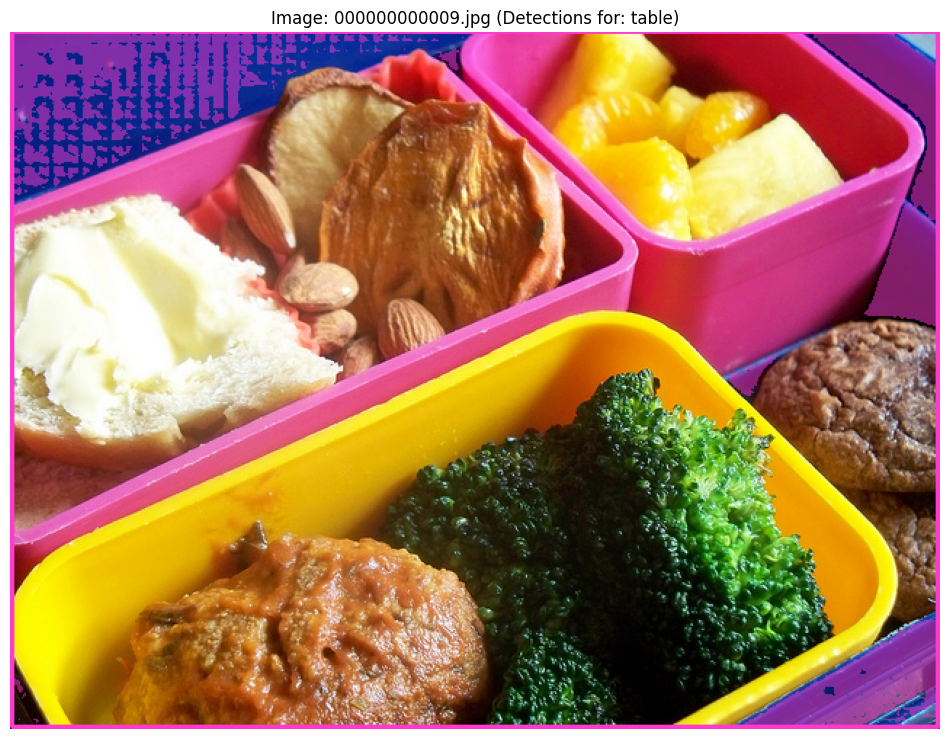

[2/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000030.jpg


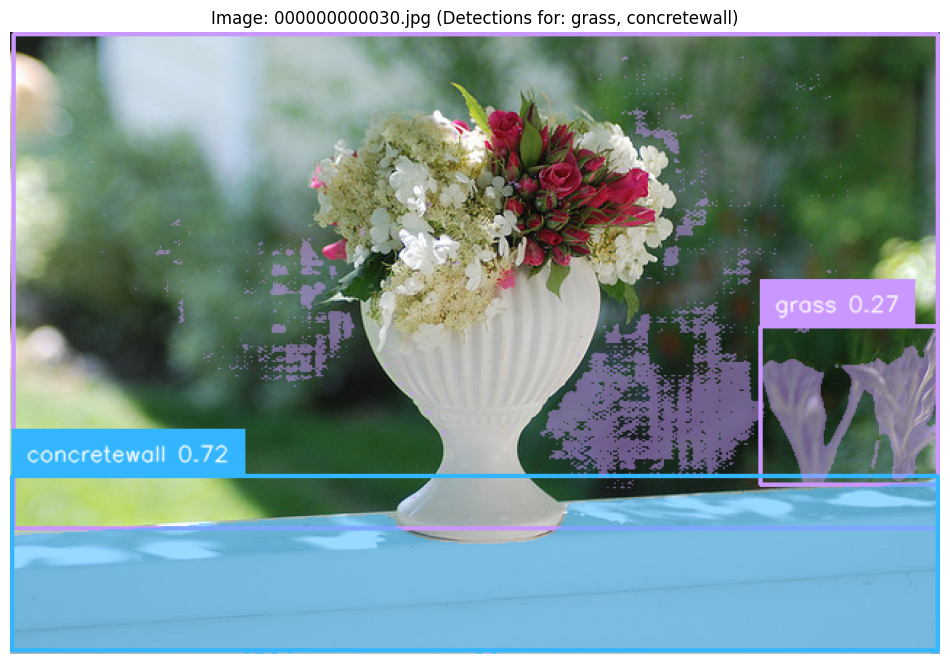

[3/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000077.jpg


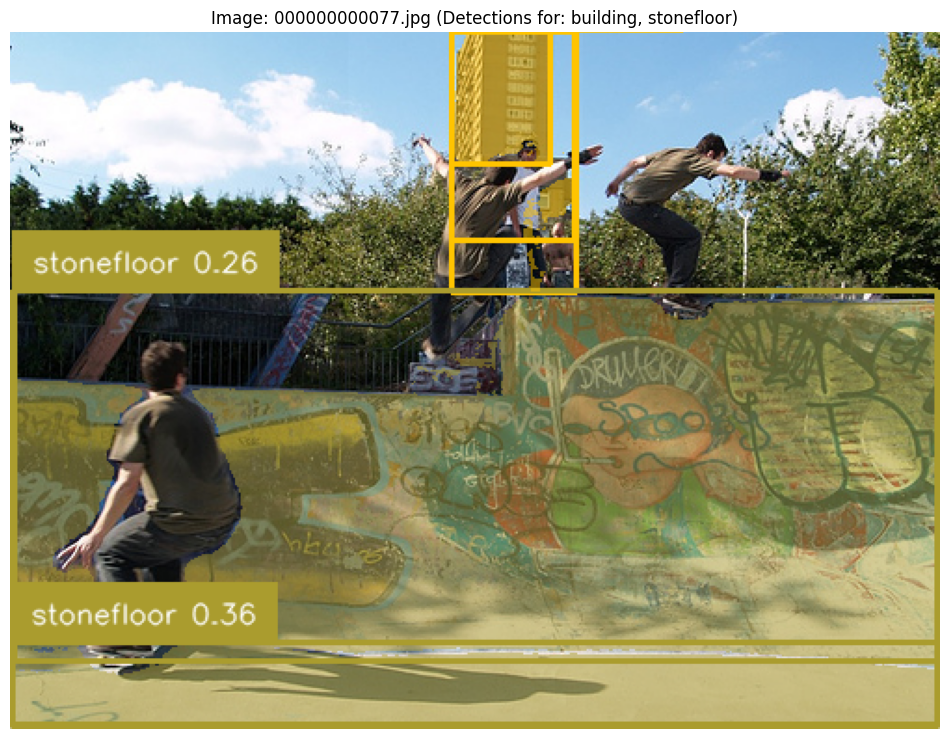

[4/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000471.jpg


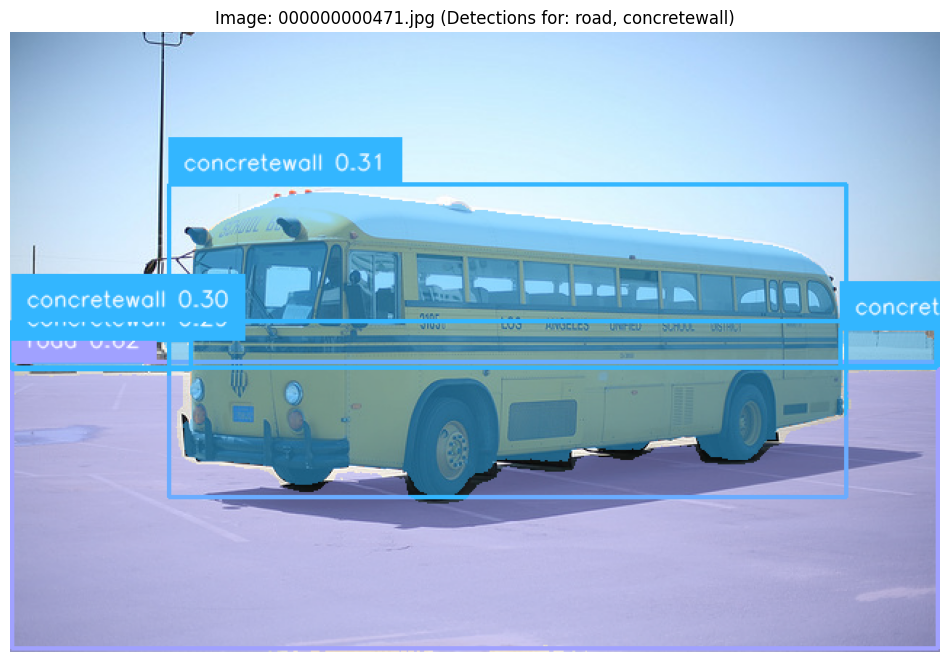

[5/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000486.jpg


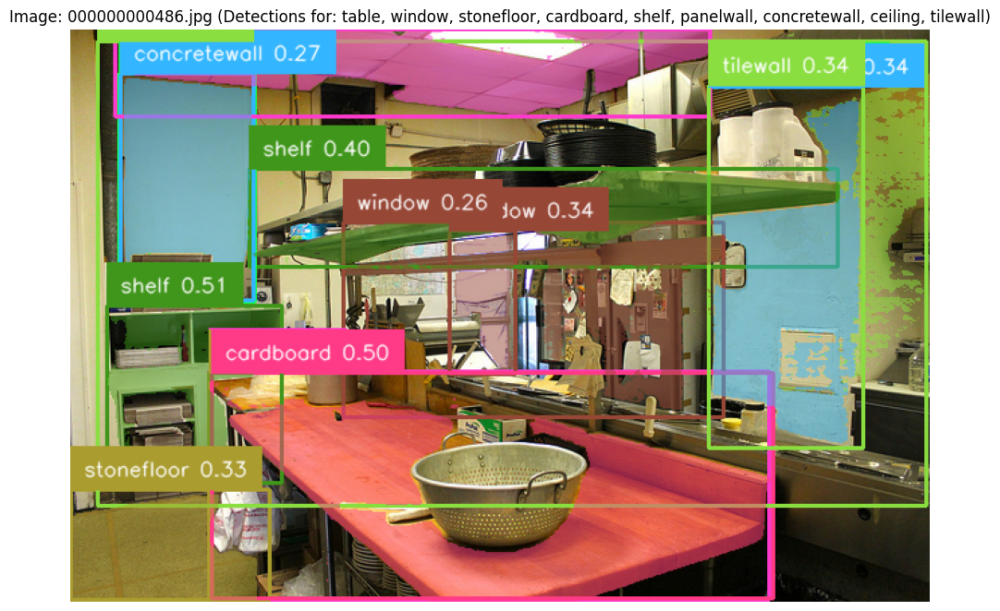

[6/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000634.jpg


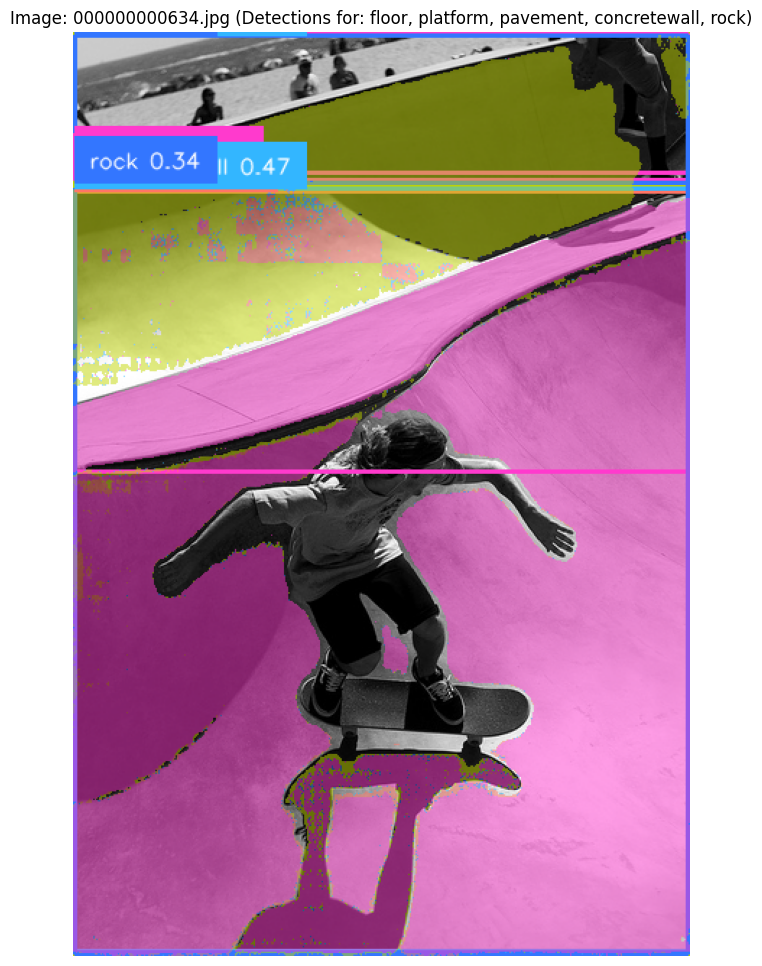

[7/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000693.jpg


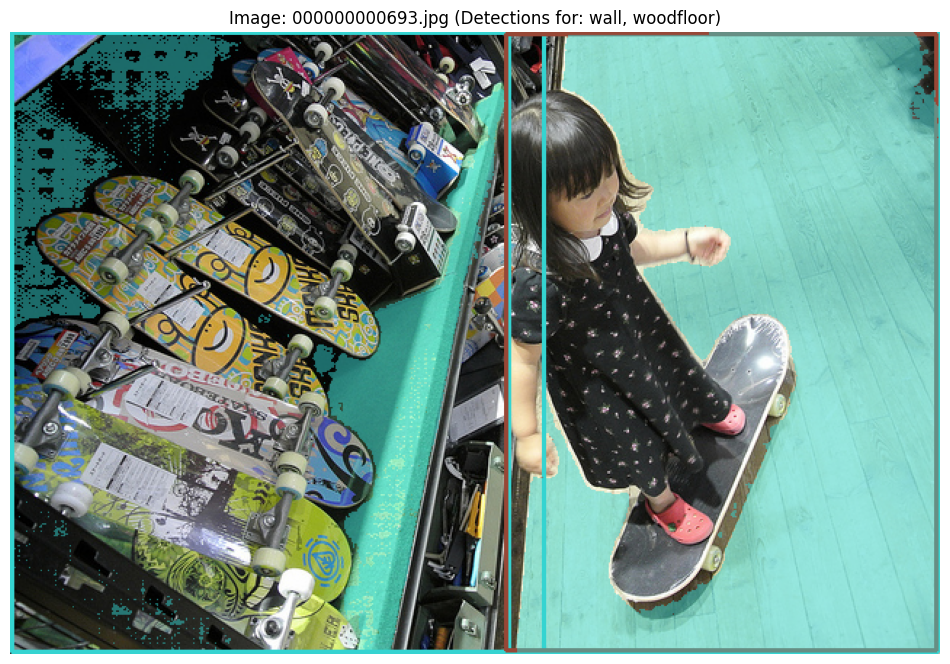

[8/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000714.jpg


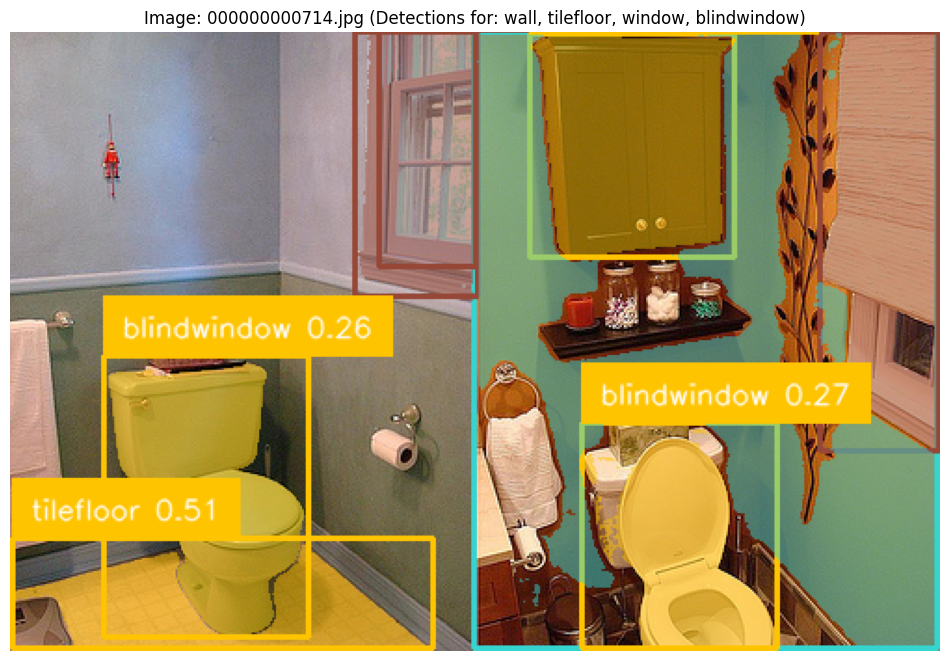

[9/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000885.jpg


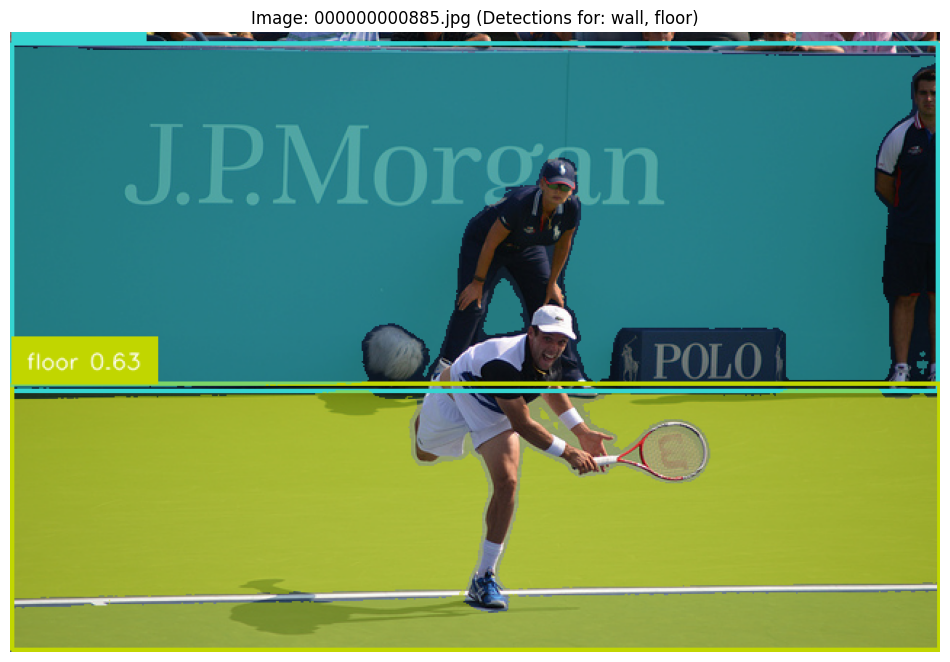

[10/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001171.jpg


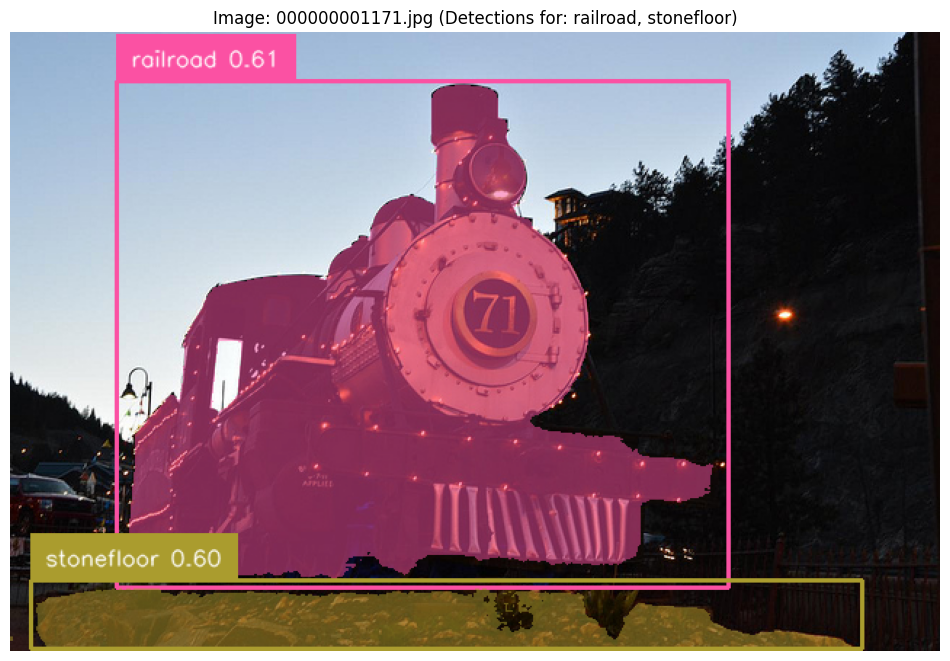

[11/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001268.jpg


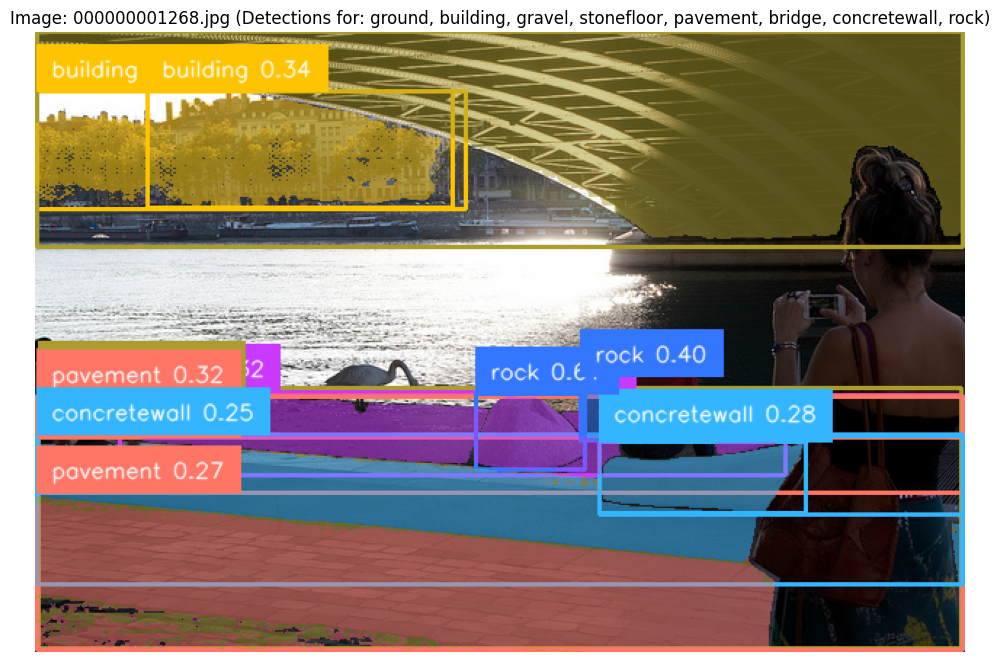

[12/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001496.jpg


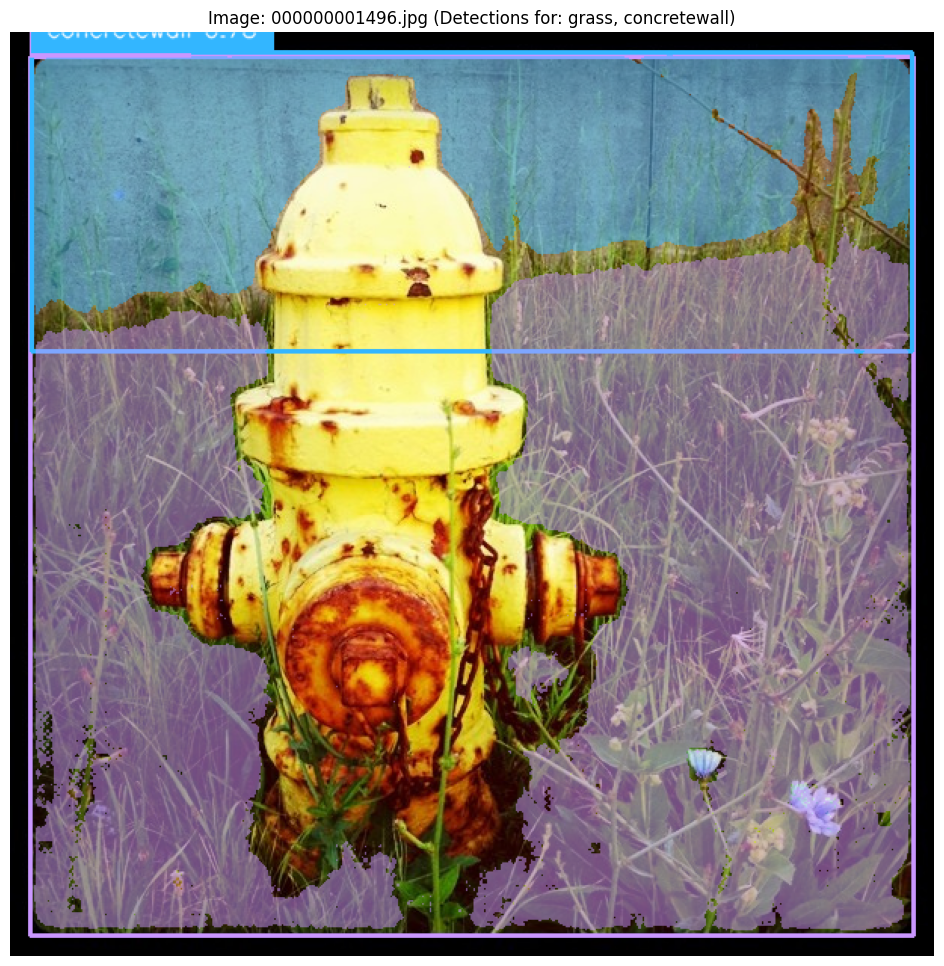

[13/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001737.jpg


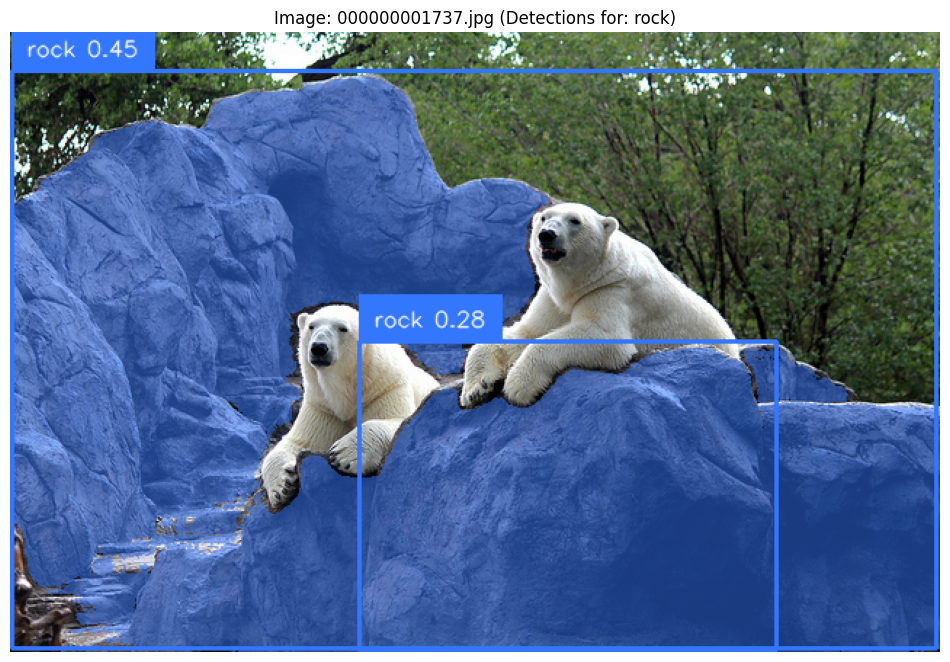

[14/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001804.jpg


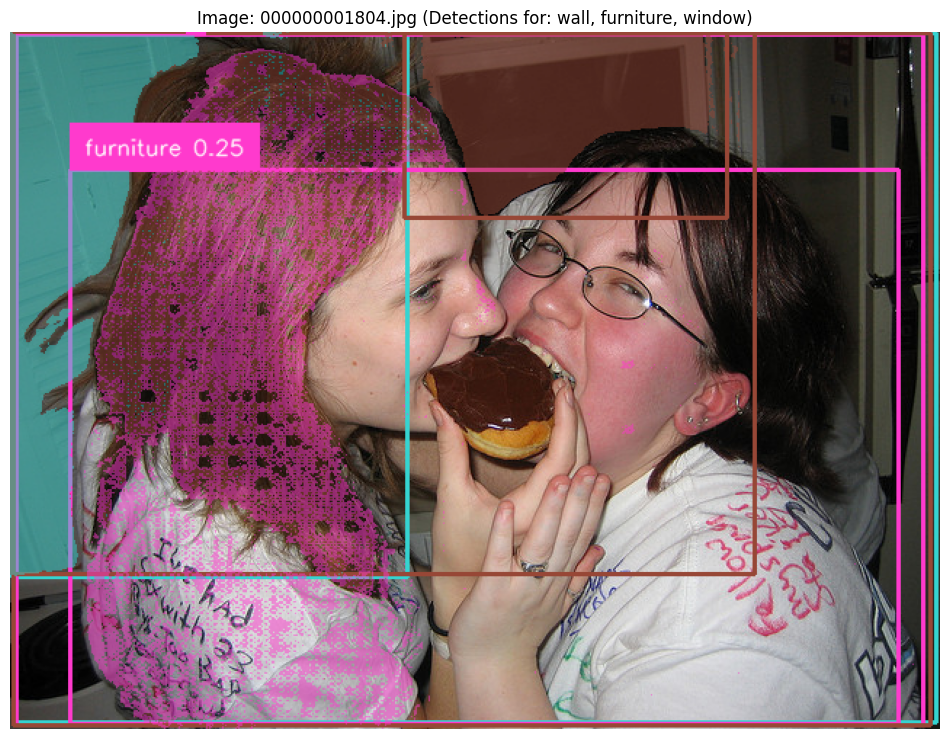

[15/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000001810.jpg


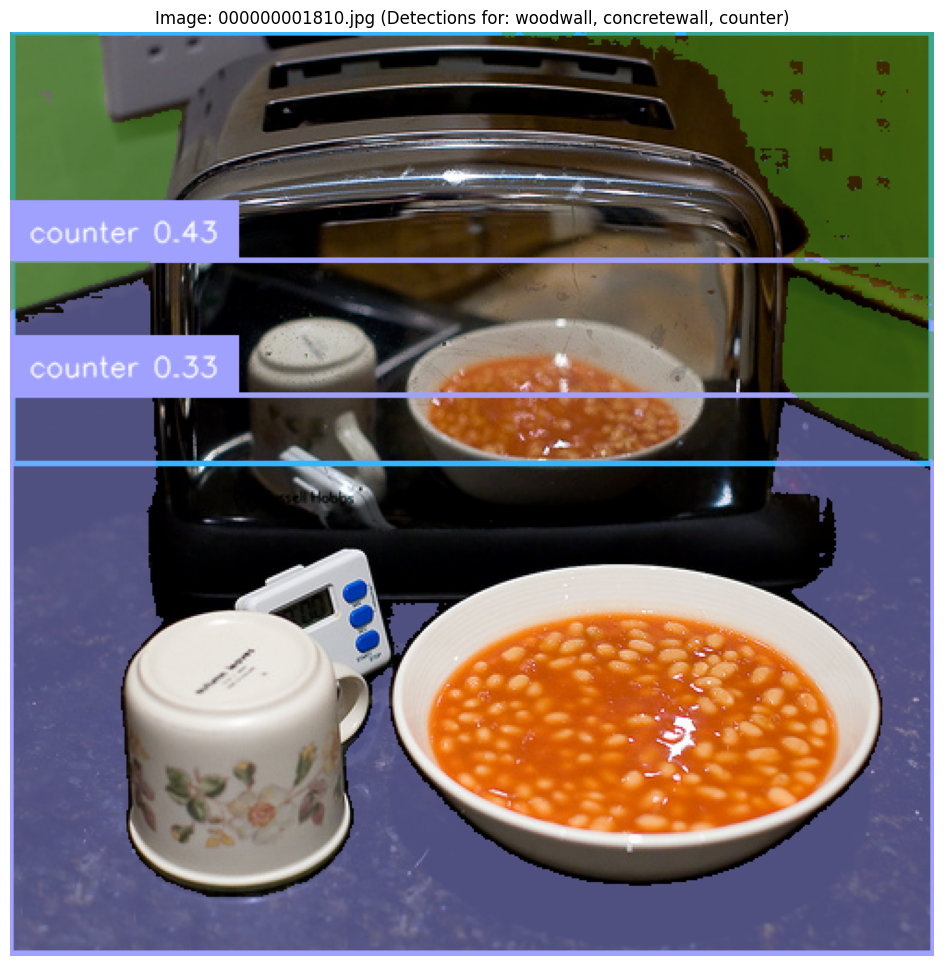

[16/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000002148.jpg


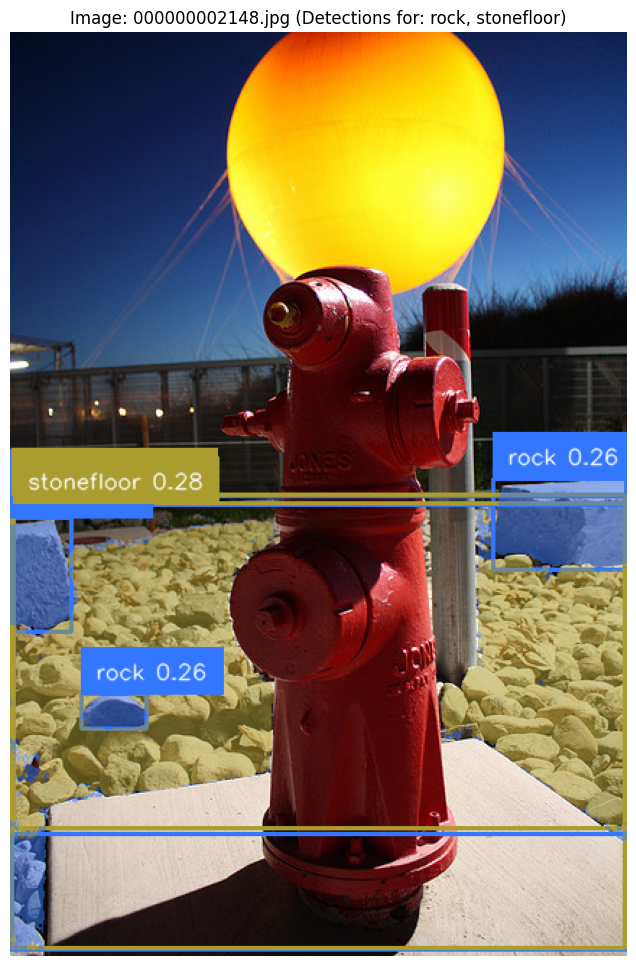

[17/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000002608.jpg


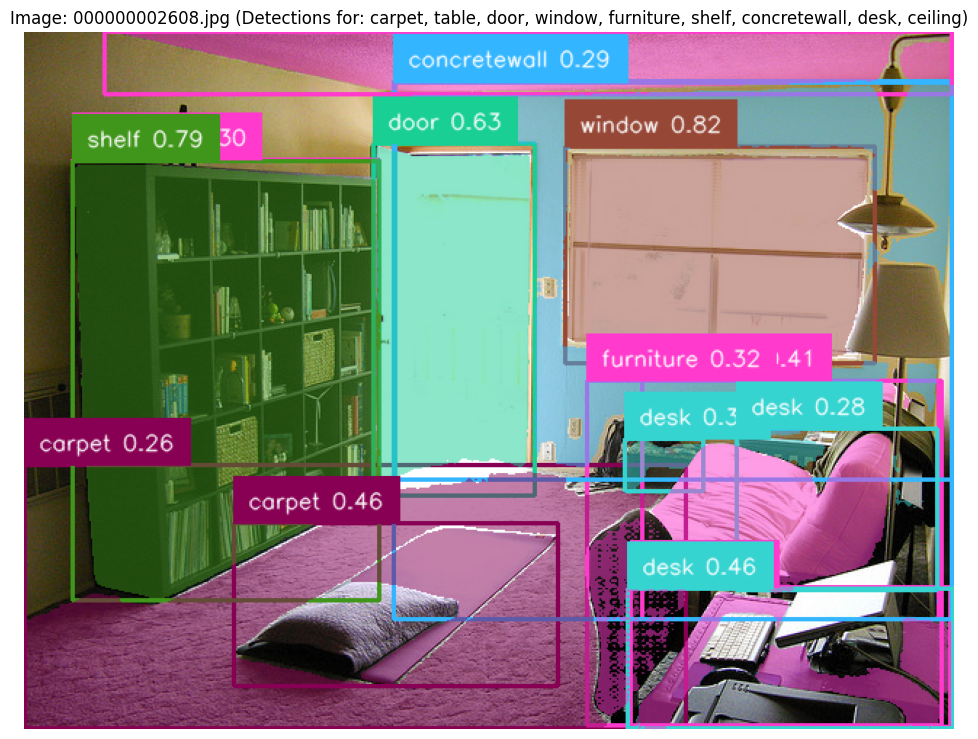

[18/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000002753.jpg


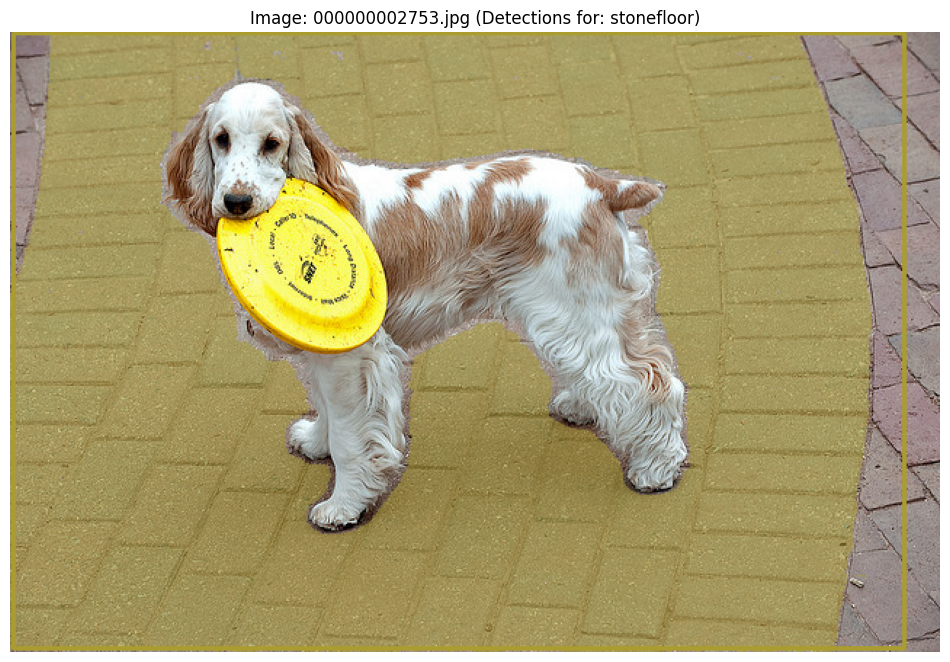

[19/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000002764.jpg


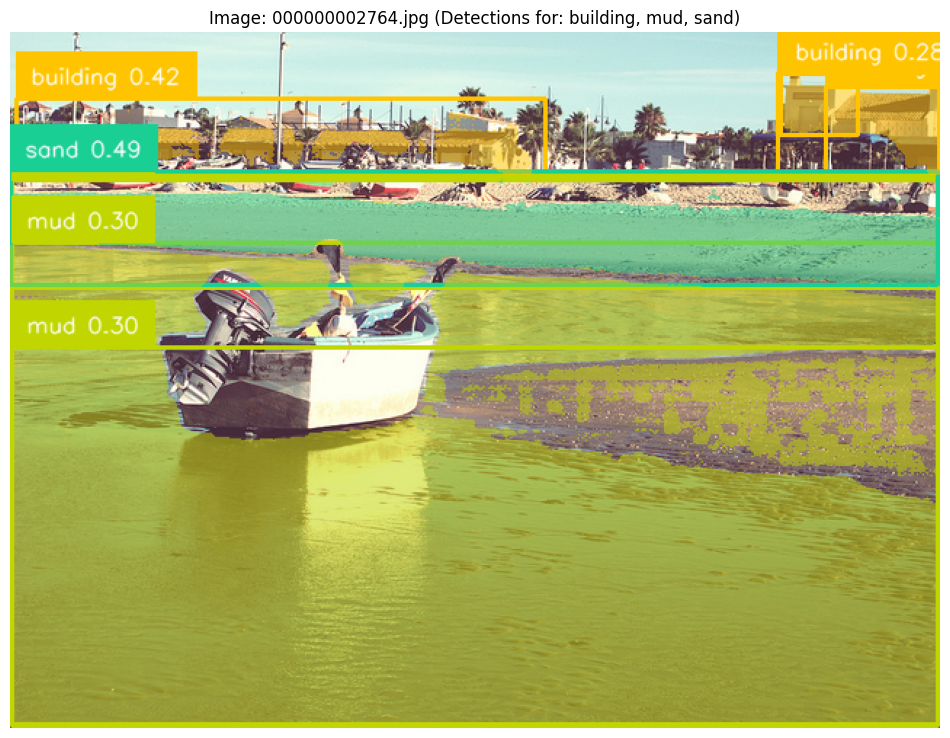

[20/20] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000003293.jpg


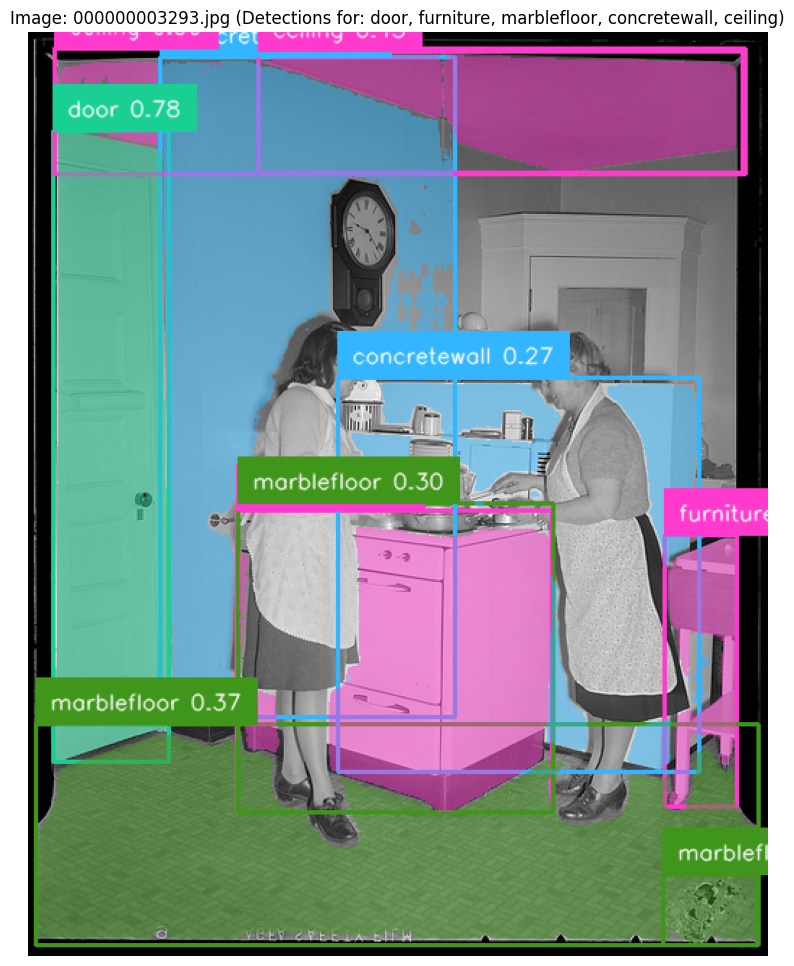

Reached sample size limit of 20. Stopping processing and visualization.

Processing complete. Results for 20 images saved to: outputs\results_stuff\sampled_20_image_results_2.json


In [8]:

BOX_THRESHOLD = 0.1
TEXT_THRESHOLD = 0.25

all_results = [] # This list will store results ONLY for the processed images

# Reverse mapping for filename -> image_id (assuming img_id_to_file is defined)
file_to_img_id = {v: k for k, v in img_id_to_file.items()}


# --- Visualization and Processing Limit ---
SAMPLE_SIZE = 20 # Define how many images you want to visualize and save results for

for idx, image_path in enumerate(image_paths):
    # Stop if we've processed and visualized the desired number of images
    if idx >= SAMPLE_SIZE:
        print(f"Reached sample size limit of {SAMPLE_SIZE}. Stopping processing and visualization.")
        break

    print(f"[{idx+1}/{min(len(image_paths), SAMPLE_SIZE)}] Processing: {image_path}")

    filename = Path(image_path).name
    image_id = file_to_img_id.get(filename)

    if image_id is None:
        print(f"No annotations found for image {filename}, skipping.")
        continue # Skip to the next image

    labels_for_image = img_id_to_labels.get(image_id, set())
    labels_for_image_norm = set(
        normalized for l in labels_for_image
        if (normalized := normalize_label(l)) is not None
    )
    filtered_labels_for_image = labels_for_image_norm.intersection(FILTERED_CLASSES)

    if not filtered_labels_for_image:
        print(f"No filtered labels for image {filename}, skipping.")
        continue # Skip to the next image

    image_source, image = load_image(image_path)
    sam2_predictor.set_image(image_source)

    all_boxes = []
    all_confidences = []
    all_labels = []

    for label in filtered_labels_for_image:
        text_prompt = label.lower() + "."
        boxes, confidences, labels = predict(
            model=grounding_model,
            image=image,
            caption=text_prompt,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD,
            device=DEVICE
        )

        if len(boxes) == 0:
            continue

        keep_indices = [
            i for i, l in enumerate(labels)
            if (normalized := normalize_label(l)) == label and normalized is not None
        ]

        if not keep_indices:
            continue

        all_boxes.append(boxes[keep_indices])
        all_confidences.append(confidences[keep_indices])
        all_labels.extend([labels[i] for i in keep_indices])

    if not all_boxes:
        print("No detections for any labels, skipping.")
        continue # Skip to the next image

    boxes = torch.cat(all_boxes, dim=0)
    confidences = torch.cat(all_confidences, dim=0)
    labels = all_labels

    h, w, _ = image_source.shape
    boxes = boxes * torch.Tensor([w, h, w, h]) # Scale boxes to original image size
    input_boxes = box_convert(boxes=boxes, in_fmt="cxcywh", out_fmt="xyxy").numpy()

    masks, scores, logits = sam2_predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_boxes,
        multimask_output=False,
    )
    if masks.ndim == 4: # Adjust mask dimensions if necessary
        masks = masks.squeeze(1)

    confidences_np = confidences.numpy().tolist()
    class_ids = np.array([cat_name_to_id[normalize_label(label)] for label in labels], dtype=np.int32)
    label_texts = [f"{label} {conf:.2f}" for label, conf in zip(labels, confidences_np)]

    detections = sv.Detections(xyxy=input_boxes, mask=masks.astype(bool), class_id=class_ids)

    # --- Visualization Code ---
    annotated_image = image_source.copy() # Make a copy to annotate
    box_annotator = sv.BoxAnnotator()
    label_annotator = sv.LabelAnnotator()
    mask_annotator = sv.MaskAnnotator()

    annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)
    annotated_image = mask_annotator.annotate(scene=annotated_image, detections=detections)
    annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections, labels=label_texts)

    plt.figure(figsize=(12, 12))
    plt.imshow(annotated_image)
    plt.title(f"Image: {filename} (Detections for: {', '.join(filtered_labels_for_image)})")
    plt.axis('off')
    plt.show()
    # --- End Visualization Code ---

    # Prepare results for saving
    mask_rles = [single_mask_to_rle(mask) for mask in masks]

    results = {
        "image_path": str(image_path), # Convert Path object to string for JSON serialization
        "annotations": [
            {
                "class_name": name,
                "class_id": cat_name_to_id[normalize_label(name)],
                "bbox": box.tolist(),
                "segmentation": rle,
                "score": score,
            }
            for name, box, rle, score in zip(labels, input_boxes, mask_rles, scores.tolist())
        ],
        "box_format": "xyxy",
        "img_width": w,
        "img_height": h,
    }

    # Append results for the current image to the list
    all_results.append(results)

# Save all results (which will contain only the SAMPLE_SIZE images due to the break)
# to a single JSON file.
final_output_path = OUTPUT_DIR / f"sampled_{SAMPLE_SIZE}_image_results_2.json"
with open(final_output_path, "w") as f:
    json.dump(all_results, f, indent=4)

print(f"\nProcessing complete. Results for {len(all_results)} images saved to: {final_output_path}")

Visualize distribution of score given to results

Successfully loaded data from outputs\results_stuff\sampled_20_image_results.json

--- Distribution of Confidence Scores (Mask Quality) ---
Total detections with score: 127
Min Score: 0.1160
Max Score: 0.9924
Mean Score: 0.9033
Median Score: 0.9410
Standard Deviation of Score: 0.1359


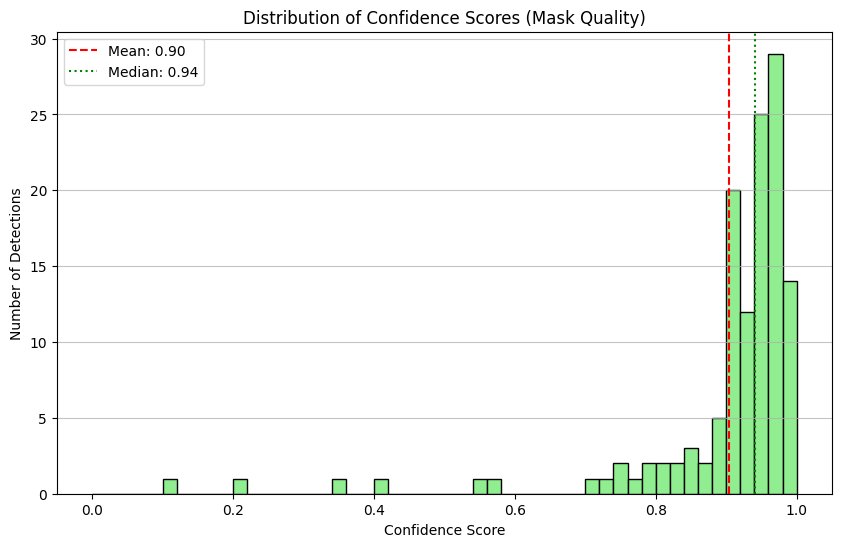


Analysis complete.


In [10]:
import json
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# Define the path to your new JSON output file
OUTPUT_DIR = Path("outputs/results_stuff")
results_file = OUTPUT_DIR / "sampled_20_image_results.json"

# --- 1. Load the JSON data ---
try:
    with open(results_file, "r") as f:
        all_inference_results = json.load(f)
    print(f"Successfully loaded data from {results_file}")
except FileNotFoundError:
    print(f"Error: The file {results_file} was not found.")
    print("Please ensure your inference script has run and saved results to this path.")
    exit()
except json.JSONDecodeError:
    print(f"Error: Could not decode JSON from {results_file}. The file might be corrupted or empty.")
    exit()

# --- 2. Extract all 'score' values (Robustly) ---
all_confidence_scores = []

for image_result in all_inference_results:
    for annotation in image_result.get("annotations", []):
        if "score" in annotation:
            current_score = annotation["score"]
            
            # Robustly handle different types of 'score' values
            if isinstance(current_score, (list, np.ndarray)):
                # If 'score' is a list or numpy array, extend our list with its elements
                # This handles cases like 'score': [0.95]
                all_confidence_scores.extend(current_score)
            elif isinstance(current_score, (int, float)):
                # If 'score' is a single number, append it directly
                all_confidence_scores.append(current_score)
            else:
                # Optionally, print a warning for unexpected types
                print(f"Warning: Annotation has a 'score' of unexpected type '{type(current_score)}'. Value: {current_score}. Skipping this score.")


if not all_confidence_scores:
    print("No numerical 'score' data found in the JSON file after robust extraction.")
    exit()

# --- 3. Calculate descriptive statistics ---
confidence_scores_np = np.array(all_confidence_scores)

print("\n--- Distribution of Confidence Scores (Mask Quality) ---")
print(f"Total detections with score: {len(confidence_scores_np)}")
print(f"Min Score: {confidence_scores_np.min():.4f}")
print(f"Max Score: {confidence_scores_np.max():.4f}")
print(f"Mean Score: {confidence_scores_np.mean():.4f}")
print(f"Median Score: {np.median(confidence_scores_np):.4f}")
print(f"Standard Deviation of Score: {confidence_scores_np.std():.4f}")

# --- 4. Create Histogram ---
plt.figure(figsize=(10, 6))
plt.hist(confidence_scores_np, bins=50, color='lightgreen', edgecolor='black', range=(0, 1))
plt.title('Distribution of Confidence Scores (Mask Quality)')
plt.xlabel('Confidence Score')
plt.ylabel('Number of Detections')
plt.grid(axis='y', alpha=0.75)
plt.axvline(x=confidence_scores_np.mean(), color='r', linestyle='--', label=f'Mean: {confidence_scores_np.mean():.2f}')
plt.axvline(x=np.median(confidence_scores_np), color='g', linestyle=':', label=f'Median: {np.median(confidence_scores_np):.2f}')
plt.legend()
plt.show()

print("\nAnalysis complete.")

## Inference Test 2 - Loop over multiple combinations of thresholds

In [10]:

# Define the ranges for Grounding DINO's internal thresholds
INFERENCE_BOX_THRESHOLDS = np.linspace(0.05, 0.9, 5).tolist() # Adjust range and step as needed
INFERENCE_TEXT_THRESHOLDS = np.linspace(0.05, 0.9, 5).tolist()

# Output base directory for all threshold combinations
BASE_OUTPUT_DIR = Path("outputs/results_stuff/threshold_tuned_inferences")
BASE_OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

# Main Loop for Threshold Tuning
for current_box_threshold in INFERENCE_BOX_THRESHOLDS:
    for current_text_threshold in INFERENCE_TEXT_THRESHOLDS:
        # Create a unique output directory for this specific threshold combination
        combo_output_dir = BASE_OUTPUT_DIR / f"box_{current_box_threshold:.2f}_text_{current_text_threshold:.2f}"
        combo_output_dir.mkdir(parents=True, exist_ok=True)

        print(f"\n--- Running Inference for Box_Thresh: {current_box_threshold:.2f}, Text_Thresh: {current_text_threshold:.2f} ---")

        all_results_for_combo = [] # List to store results for this specific combination

        for idx, image_path in enumerate(image_paths):
            print(f"[{idx+1}/{len(image_paths)}] Processing: {image_path} "
                  f"for Box_Thresh={current_box_threshold:.2f}, Text_Thresh={current_text_threshold:.2f}")

            filename = Path(image_path).name
            image_id = file_to_img_id.get(filename) # Assuming file_to_img_id is already defined
        
            if image_id is None:
                # print(f"No annotations found for image {filename}, skipping.") # Avoid too much verbose output
                continue

            labels_for_image = img_id_to_labels.get(image_id, set()) # Assuming img_id_to_labels is defined
            labels_for_image_norm = set(
                normalized for l in labels_for_image
                if (normalized := normalize_label(l)) is not None
            )

            if not labels_for_image_norm:
                # print(f"No normalized labels for image {filename}, skipping.")
                continue

            image_source, image = load_image(image_path)
            sam2_predictor.set_image(image_source)

            all_gd_boxes = []
            all_gd_confidences = []
            all_gd_labels = []

            for label in labels_for_image_norm:
                text_prompt = label.lower() + "."
                boxes, confidences, gd_output_labels = predict(
                    model=grounding_model,
                    image=image,
                    caption=text_prompt,
                    # Crucial Change: Use the current thresholds for inference
                    box_threshold=current_box_threshold,
                    text_threshold=current_text_threshold,
                    device=DEVICE
                )

                if len(boxes) == 0:
                    continue

                # Filter Grounding DINO outputs to only keep detections matching the current normalized label
                keep_indices = [
                    i for i, l in enumerate(gd_output_labels)
                    if (normalized := normalize_label(l)) == label and normalized is not None
                ]

                if not keep_indices:
                    continue

                all_gd_boxes.append(boxes[keep_indices])
                all_gd_confidences.append(confidences[keep_indices])
                all_gd_labels.extend([gd_output_labels[i] for i in keep_indices])

            if not all_gd_boxes:
                # print("No detections for any labels after GD filtering, skipping SAM2.")
                continue

            # Concatenate all collected Grounding DINO results
            final_gd_boxes = torch.cat(all_gd_boxes, dim=0)
            final_gd_confidences = torch.cat(all_gd_confidences, dim=0)

            h, w, _ = image_source.shape
            pixel_gd_boxes = final_gd_boxes * torch.Tensor([w, h, w, h])
            input_boxes_for_sam = box_convert(boxes=pixel_gd_boxes, in_fmt="cxcywh", out_fmt="xyxy").numpy()

            # Predict masks with SAM-2
            masks, scores_tensor, logits = sam2_predictor.predict(
                point_coords=None,
                point_labels=None,
                box=input_boxes_for_sam,
                multimask_output=False,
            )
            if masks.ndim == 4:
                masks = masks.squeeze(1)

            # Ensure scores_tensor is a 1D tensor (e.g., (N,)) before converting to a list
            # If it's (N, 1), squeeze it to (N,)
            if scores_tensor.ndim > 1:
                scores_tensor = scores_tensor.squeeze()
            
            # Now convert to a flat Python list of floats
            sam_scores_list = scores_tensor.tolist() 

            final_gd_confidences_list = final_gd_confidences.numpy().tolist()

            mask_rles = [single_mask_to_rle(mask_item) for mask_item in masks]

            results = {
                "image_path": image_path,
                "annotations": [
                    {
                        "class_name": name,
                        "class_id": cat_name_to_id[normalize_label(name)], # Assuming cat_name_to_id is defined
                        "bbox": box.tolist(),
                        "segmentation": rle_mask,
                        "score" : score,
                        # The GD confidence here is the *result* after applying current_box_threshold and current_text_threshold
                        "grounding_dino_final_confidence": float(gd_conf_val),
                    }
                    for name, box, rle_mask, score, gd_conf_val in zip(
                        all_gd_labels, # Use all_gd_labels as that's what GD returned and was filtered
                        input_boxes_for_sam,
                        mask_rles,
                        sam_scores_list,
                        final_gd_confidences_list
                    )
                ],
                "box_format": "xyxy",
                "img_width": w,
                "img_height": h,
            }

            all_results_for_combo.append(results)

        # Save results for the current threshold combination
        combo_output_file = combo_output_dir / "inference_results.json"
        with open(combo_output_file, "w") as f:
            json.dump(all_results_for_combo, f, indent=4)
        print(f"Results for Box_Thresh={current_box_threshold:.2f}, Text_Thresh={current_text_threshold:.2f} saved to {combo_output_file}")



--- Running Inference for Box_Thresh: 0.05, Text_Thresh: 0.05 ---
[1/2996] Processing: C:/Users/User/Projects/ObjectDetection/object_detection_exploration/custom_coco_stuff_dataset_3000\000000000009.jpg for Box_Thresh=0.05, Text_Thresh=0.05


KeyboardInterrupt: 

## Inference Test 3
- Raw detections at 0.01 for thresholds 
- Post processing done in separate step

In [7]:
# --- Configuration for Raw Detections ---
RAW_OUTPUT_DIR = Path("outputs/raw_detections_single_pass")
RAW_OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

# Set very low thresholds for raw detection to capture almost everything.
RAW_BOX_THRESHOLD = 0.1
RAW_TEXT_THRESHOLD = 0.25

print(f"\n--- Running Raw Inference (Box Thresh: {RAW_BOX_THRESHOLD}, Text Thresh: {RAW_TEXT_THRESHOLD}) ---")

all_raw_inference_results = [] # List to store raw results for all images
total_images = len(image_paths)
start_time_overall = time.time() # Record the start time of the entire process

for idx, image_path in enumerate(image_paths):
    # Calculate and print progress and estimated time left
    images_processed = idx + 1
    
    # Calculate average time per image after a few iterations for stability
    if images_processed > 0:
        elapsed_time_so_far = time.time() - start_time_overall
        avg_time_per_image = elapsed_time_so_far / images_processed
        remaining_images = total_images - images_processed
        estimated_time_left_seconds = remaining_images * avg_time_per_image

        # Convert seconds to HH:MM:SS format
        m, s = divmod(estimated_time_left_seconds, 60)
        h, m = divmod(m, 60)
        estimated_time_left_str = f"{int(h):02}:{int(m):02}:{int(s):02}"
    else:
        estimated_time_left_str = "Calculating..."

    # Print concise progress update
    print(f"[{images_processed}/{total_images}] Processing... Estimated Time Left: {estimated_time_left_str}", end='\r')


    filename = Path(image_path).name
    image_id = file_to_img_id.get(filename)

    if image_id is None:
        continue

    labels_for_image = img_id_to_labels.get(image_id, set())
    labels_for_image_norm = set(
        normalized for l in labels_for_image
        if (normalized := normalize_label(l)) is not None
    )

    if not labels_for_image_norm:
        continue

    image_source, image = load_image(image_path)
    sam2_predictor.set_image(image_source)

    all_boxes = []
    all_confidences = []
    all_labels = []

    for label in labels_for_image_norm:
        text_prompt = label.lower() + "."
        
        boxes, confidences, output_labels = predict(
            model=grounding_model,
            image=image,
            caption=text_prompt,
            box_threshold=RAW_BOX_THRESHOLD,
            text_threshold=RAW_TEXT_THRESHOLD,
            device=DEVICE
        )

        if len(boxes) == 0:
            continue

        keep_indices = [
            i for i, l in enumerate(output_labels)
            if (normalized := normalize_label(l)) == label and normalized is not None
        ]

        if not keep_indices:
            continue

        all_boxes.append(boxes[keep_indices])
        all_confidences.append(confidences[keep_indices])
        all_labels.extend([output_labels[i] for i in keep_indices])

    if not all_boxes:
        continue

    final_boxes = torch.cat(all_boxes, dim=0)
    final_confidences_for_output = torch.cat(all_confidences, dim=0)

    h, w, _ = image_source.shape
    pixel_boxes = final_boxes * torch.Tensor([w, h, w, h])
    input_boxes = box_convert(boxes=pixel_boxes, in_fmt="cxcywh", out_fmt="xyxy").numpy()

    masks, scores_tensor, logits = sam2_predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_boxes,
        multimask_output=False,
    )
    if masks.ndim == 4:
        masks = masks.squeeze(1)

    if scores_tensor.ndim > 1:
        scores_tensor = scores_tensor.squeeze()
            
    sam_scores_list = scores_tensor.tolist()

    box_confidences_list = final_confidences_for_output.numpy().tolist()

    mask_rles = [single_mask_to_rle(mask_item) for mask_item in masks]

    results_for_image = {
        "image_path": image_path,
        "annotations": [
            {
                "class_name": name,
                "class_id": cat_name_to_id[normalize_label(name)],
                "bbox": box.tolist(),
                "segmentation": rle_mask,
                "sam2_iou_score": float(sam_score_val),
                "box_confidence": float(box_conf_val), 
            }
            for name, box, rle_mask, sam_score_val, box_conf_val in zip(
                all_labels,
                input_boxes,
                mask_rles,
                sam_scores_list,
                box_confidences_list
            )
        ],
        "box_format": "xyxy",
        "img_width": w,
        "img_height": h,
    }

    all_raw_inference_results.append(results_for_image)

# Clear the last progress line and print final message
print("\n" + "="*50)
print(f"Finished processing all {total_images} images.")

# Save all raw results to a single JSON file
raw_output_file = RAW_OUTPUT_DIR / "raw_inference_results.json"
with open(raw_output_file, "w") as f:
    json.dump(all_raw_inference_results, f, indent=4)
print(f"All raw inference results saved to {raw_output_file}")


--- Running Raw Inference (Box Thresh: 0.1, Text Thresh: 0.25) ---


KeyboardInterrupt: 

In [42]:
def inspect_text_prompt_for_image(image_filename):
    image_id = file_to_img_id.get(image_filename)
    if image_id is None:
        print(f"Image '{image_filename}' not found in annotation mapping.")
        return

    # Get raw labels for the image
    raw_labels = img_id_to_labels.get(image_id, set())
    normalized_labels = set(
        normalized for l in raw_labels
        if (normalized := normalize_label(l)) is not None
    )
    filtered_labels = normalized_labels.intersection(FILTERED_CLASSES)

    if not filtered_labels:
        print(f"No filtered labels for image '{image_filename}'.")
        return

    # Create the prompt
    text_prompt = ", ".join(filtered_labels).lower() + "."

    # Display results
    print(f"\nImage: {image_filename}")
    print("Raw labels from annotation:", raw_labels)
    print("Normalized labels:", normalized_labels)
    print("Filtered labels (used in prompt):", filtered_labels)
    print("Generated text prompt:", text_prompt)


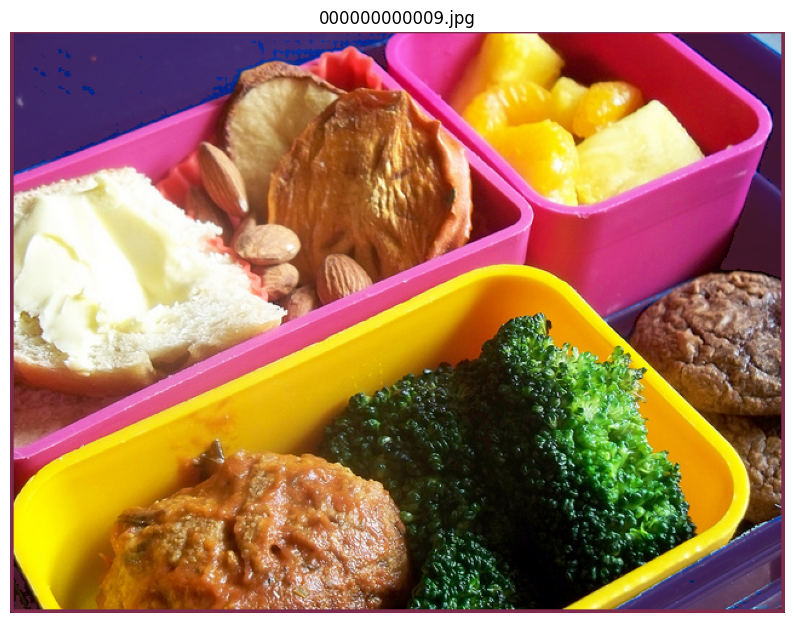

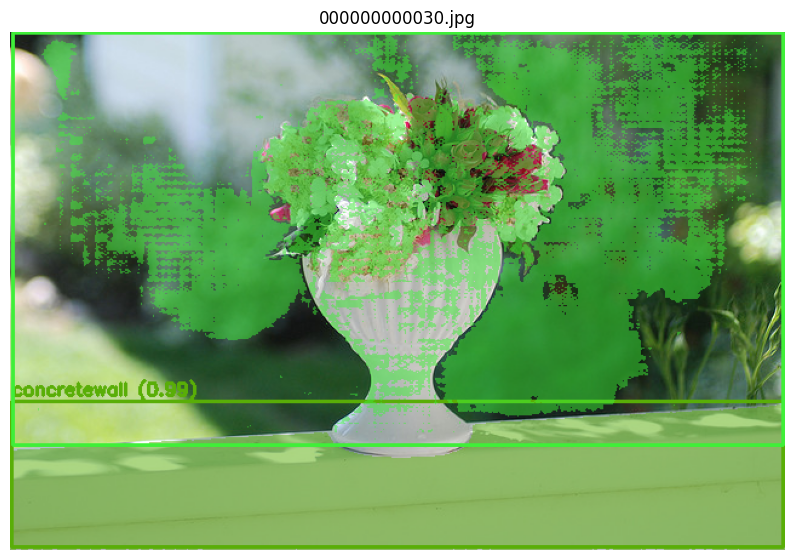

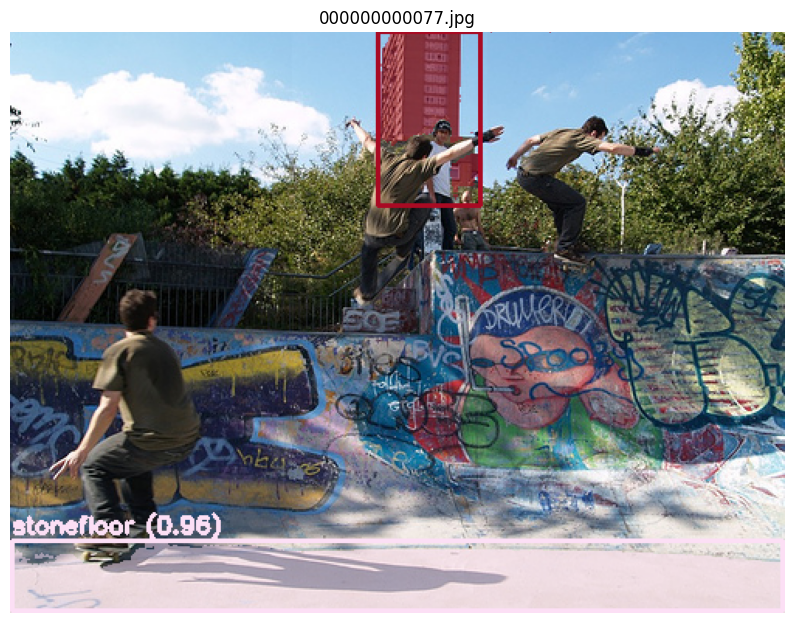

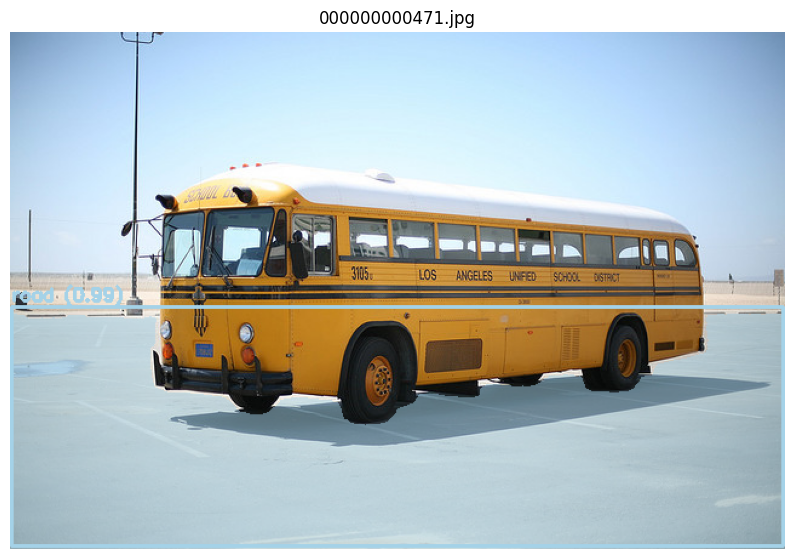

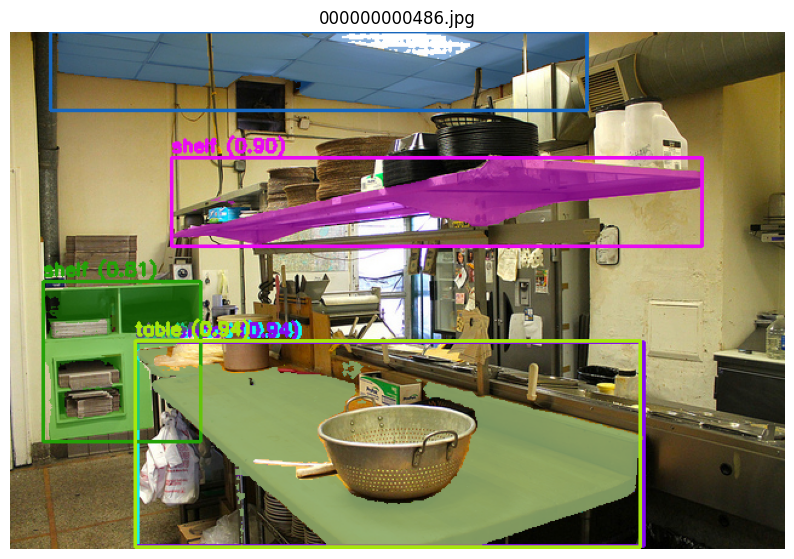

In [15]:
import json
from pathlib import Path
import cv2
from pycocotools import mask as mask_util
import numpy as np
import matplotlib.pyplot as plt

# Load JSON results
with open("outputs/results_stuff/all_image_results.json", "r") as f:
    all_results = json.load(f)

# Function to visualize one image result
def visualize_result(entry):
    image_path = entry["image_path"]
    annotations = entry["annotations"]

    if not Path(image_path).exists():
        print(f"Image not found: {image_path}")
        return

    # Load image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Overlay masks and boxes
    for ann in annotations:
        bbox = ann["bbox"]
        class_name = ann["class_name"]
        score = ann["score"]

        # Fix: Unwrap score if it's a list
        if isinstance(score, list):
            score = score[0]

        rle = ann["segmentation"]

        # Decode RLE mask
        mask = mask_util.decode(rle)

        # Create a colored overlay for the mask
        color = np.random.randint(0, 255, (3,), dtype=np.uint8)
        image[mask == 1] = image[mask == 1] * 0.5 + color * 0.5

        # Draw bounding box
        x1, y1, x2, y2 = map(int, bbox)
        cv2.rectangle(image, (x1, y1), (x2, y2), color.tolist(), 2)

        # Draw label
        label = f"{class_name} ({score:.2f})"
        cv2.putText(image, label, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color.tolist(), 2)

    # Show result
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.axis("off")
    plt.title(Path(image_path).name)
    plt.show()

# Visualize first 5 images
for result in all_results[:5]:
    visualize_result(result)
